#  利用多光谱遥感数据进行地物分类

#### 本课程目的是利用神经网络开展多光谱地物分类，学习从整幅卫星影像制作样本数据集，训练多分类神经网络，并实现对整景卫星数据的预测。
运行该代码提前需要安装以下几个必要的库
1. numpy
2. tensorflow = 2.5 
3. h5py = 3.1
4. Pillow = 8.4 

In [1]:
import h5py
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.optimizers import RMSprop,Adam
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau,CSVLogger
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import time,glob
from model import all_model
from utils import *

### 1. 加载并查看数据


In [2]:
## 加载数据集，数据集维度为3840×3840×4，最后一个波段是真值标签，标签一共有六类，“”
hdf5_path = "../data/kaggle_14_3b_5c.hdf5"
fd = h5py.File(hdf5_path, 'r')
fd.keys()
images=fd['image']
labels=fd['label']
n_label=len(np.unique(labels)) #{0:'buiding',1:'Road', 2:'Tree',3: 'Crops',4:'Water'}
## 该影像是反射率数据（通常数值在0-1之间），为了节省存储空间常将数值放大10000倍，保存为无符号整型数据
print(np.max(images),np.min(images),np.max(labels),np.min(labels))
images=np.array(images)
labels=np.array(labels)
print(images.shape,labels.shape)


9995 213 4 0
(14, 3840, 3840, 3) (14, 3840, 3840)


9995 1.0


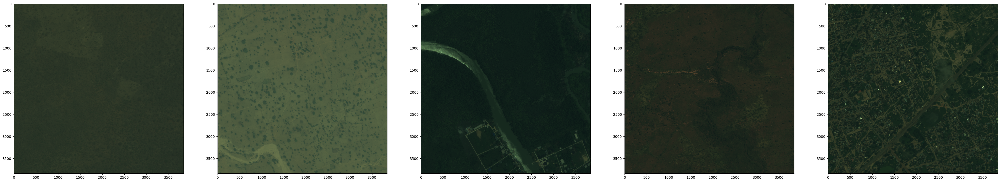

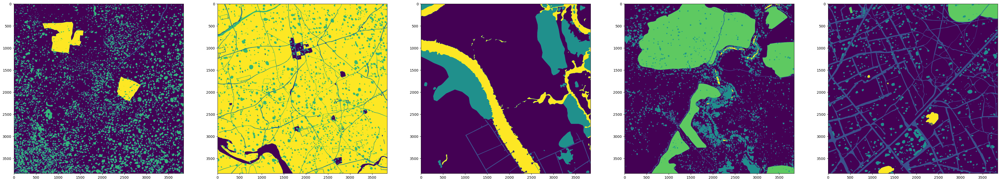

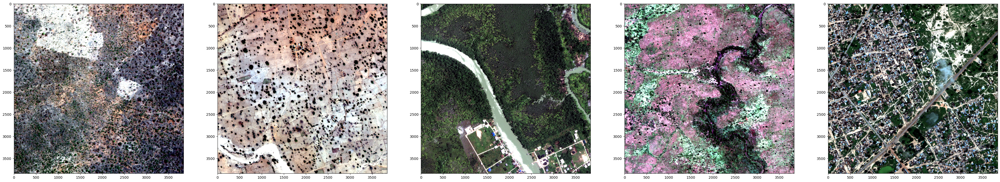

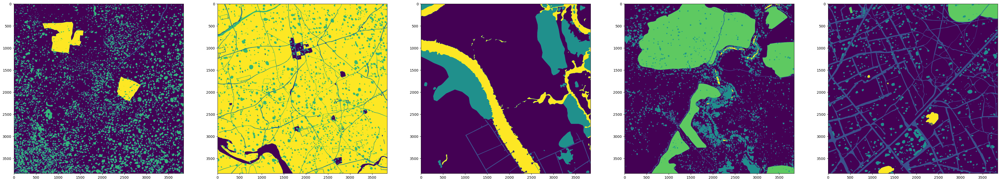

In [ ]:
## 将整幅影像及标签数据打印出来,为了提升原始影像的显示效果，对原有数据进行拉伸处理 

def stretch_n(band, lower_percent=5, higher_percent=95): #5和95表示分位数
    band=np.array(band,dtype=np.float32)
    c = np.percentile(band, lower_percent)*1.0
    d = np.percentile(band, higher_percent)*1.0       
    band[band<c] = c
    band[band>d] = d
    out =  (band - c)  / (d - c)  
    return out.astype(np.float32)

def adjust_contrast(data,n_band=3):    #通过循环对各个波段进行拉伸
    data=np.array(data,dtype=np.float32)
    for img in data:
        for k in range(n_band):
            img[:,:,k] = stretch_n(img[:,:,k])
    return data

newimg=adjust_contrast(images.copy()) #该操作讲改变原始数据，因此用.copy，不对原始数据进行更改
print(np.max(images),np.max(newimg))
show_5_images(images/10000,labels)#plot函数要求数据为0-1之间的浮点型或0-255的8位整型数据
show_5_images(newimg,labels)



### 2. 数据切片

In [ ]:
## 定义随机裁剪和顺序裁剪两种方式，顺序裁剪是按照固定步长沿行列循环裁剪，切片数是有限的，随机裁剪是以随机点为起始点裁剪，切片数可以是无限的且可自定义，后者的好处是可以通过增加算法约束label中某一类的数量来实现精准的样本获取。
def random_crop(image,crop_sz):
    img_sz=image.shape[:2]
    random_x = np.random.randint(0,img_sz[0]-crop_sz+1) ##生成随机点
    random_y = np.random.randint(0,img_sz[1]-crop_sz+1)
    s_img = image[random_x:random_x+crop_sz,random_y:random_y+crop_sz,:] ##以随机点为起始点生成样本框，进行切片
    return s_img

def data_crop_random(img_arr,crop_sz,n_patch):   
    c = img_arr.shape[-1]
    data = np.zeros([n_patch, crop_sz, crop_sz, c])
    for j in np.arange(n_patch):
        image = random_crop(img_arr,crop_sz)
        data[ j,:,:,:] = image
    return data
def sequential_crop(imagearray,crop_sz,step=256):
    data = []
    x=0
    row_num = ((imagearray.shape)[0] - step) // step  ##最多能裁剪几行 几列
    col_num=((imagearray.shape)[1] - step) // step
    x_start=0
    y_start=0
    for h in range(row_num):
        for w in range(col_num):
            crop_img = imagearray[crop_sz*h+y_start:crop_sz*(h+1)+y_start, crop_sz*w+x_start:crop_sz*(w+1)+x_start,:] ##行列循环，滑动窗口移动              
            data.append(crop_img)
            x=x+1
    data=np.array(data)
    return data
def data_crop(imagearray,crop_sz,stride,random=None,n_patch=250):   #设置random选项，用来切换是否采用随机裁切
    data = []
    for i in range(imagearray.shape[0]):
        if random:
            image=data_crop_random(imagearray[i,:,:,:],crop_sz,n_patch)
        else:
            image =sequential_crop(imagearray[i,:,:,:],crop_sz,stride)
        if i == 0:
            data  = image ##注意当i=0的时候需要将image赋给data，否则data依然是空，不可以进行concatnate
        else:
            data  = np.concatenate((data, image), axis = 0) 
        print("patch processing....:"+str(i))
    data=np.array(data,dtype=np.float32)
    print("final processed:"+str(i)+"...No.:"+str(data.shape[0]))    
    return data


In [6]:
## 合并images和labels方便切片
data_all = np.concatenate((newimg, np.expand_dims(labels,axis=-1)), axis = -1)
stride=256
cropsize=256
all_patches=data_crop(data_all,cropsize,stride,random=False)##保留2景数据做测试
print(data_all.shape,all_patches.shape)
i=0


patch processing....:0
patch processing....:1
patch processing....:2
patch processing....:3
patch processing....:4
patch processing....:5
patch processing....:6
patch processing....:7
patch processing....:8
patch processing....:9
patch processing....:10
patch processing....:11
patch processing....:12
patch processing....:13
final processed:13...No.:2744
(14, 3840, 3840, 4) (2744, 256, 256, 4)


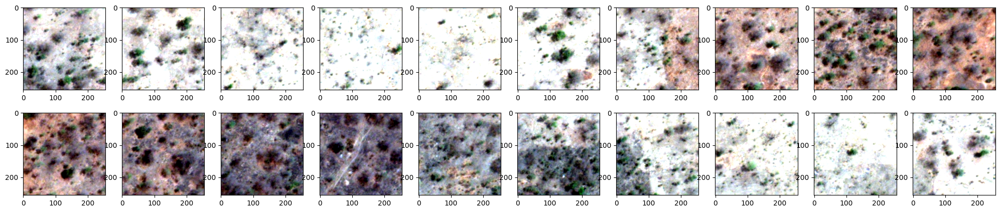

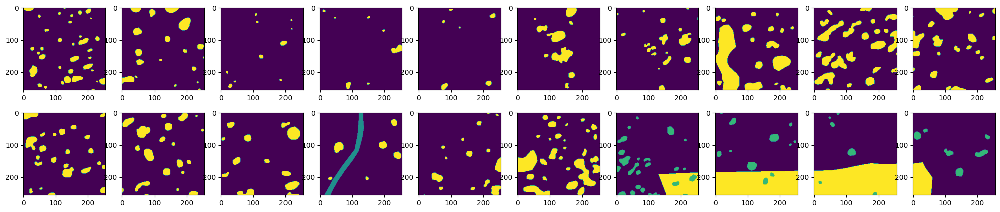

In [7]:
##调用utils中的plot_func查看数据与label是否对应,反复运行这个cell进行数据浏览i表示每次浏览跨越数据的个数
plot_func(all_patches[i:i+20,:,:,:3],all_patches[i:i+20:,:,:,-1])
i+=500

In [8]:
all_patches=suffle_data(all_patches) #对数据进行打乱处理

(2744, 256, 256, 4)


In [9]:
##可以选择将数据保存为h5文件，方便后续使用
hdf5_path = '../data/patches_rgb_4b_5c.hdf5' 
f = h5py.File(hdf5_path, mode='w')
f['image'] = all_patches[:,:,:,0:-1]
f['label'] = all_patches[:,:,:,-1]
f.close()

### 3. 模型训练

In [3]:
hdf5_path = "../data/patches_rgb_4b_5c.hdf5"
fd = h5py.File(hdf5_path, 'r')
fd.keys()
images=np.array(fd['image'])
labels=np.array(fd['label'])#3:tree,4:road,5:crop

In [4]:
## 对数据进行归一化处理，并将label转成one-hot标签形式
# n_label=5
def post_normalize_image(images,labels,n_label=n_label):
    msk = label_hot(labels,n_label)
    img = images
    return img,msk
img,msk=post_normalize_image(images,labels,n_label)
# img,msk=post_normalize_image(all_patches[:,:,:,0:-1],all_patches[:,:,:,-1],n_label)
## 将数据集按照7:3进行划分
xtrain,xtest,ytrain,ytest=train_test_split(img,msk,test_size=0.2,random_state=42)
del img,msk #如果数据较大可以在此删除降低内存
print(xtrain.shape,xtest.shape,ytrain.shape,ytest.shape)
i=0

(2195, 256, 256, 3) (549, 256, 256, 3) (2195, 256, 256, 5) (549, 256, 256, 5)


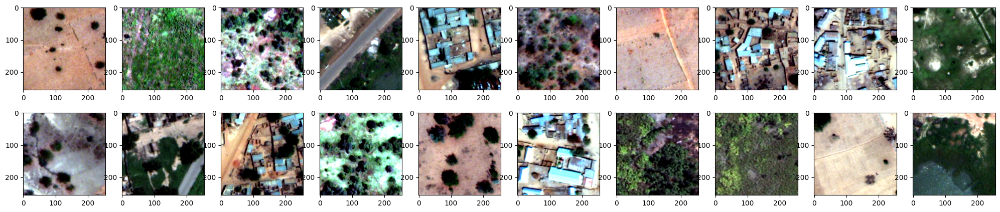

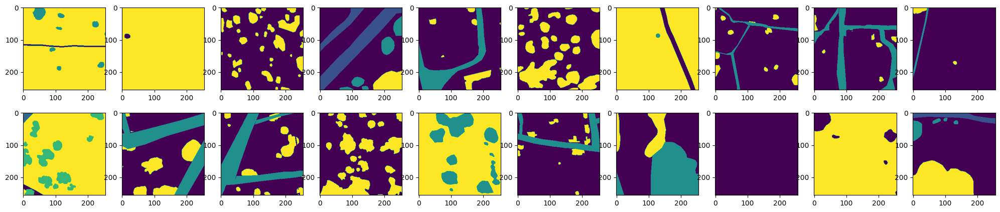

In [5]:
plot_func(xtrain[i:i+20,:,:,:3],np.argmax(ytrain,axis=-1)[i:i+20:,:,:])
i+=500

In [6]:
## 设定必要的参数
loss='categorical_crossentropy'
optimizer=Adam()
loss_weights=''
metrics=['accuracy']
batch_size=20
epoch= 50
input_height=xtrain.shape[1]
input_width=xtrain.shape[2]
nchannel=xtrain.shape[-1]
num_train=xtrain.shape[0]
num_val=xtest.shape[0]
ATM=all_model(loss,loss_weights,optimizer,metrics,input_height,input_width,n_label,nchannel) #向all_model传参返回模型
modelname='unettest'

In [7]:
## 加载UNET模型
model=ATM.UNET()#deeplabv3p,UNET,dlinknet,convattunet
# model.summary()

In [ ]:
## 开始训练
begin_time = time.time()          
out_dir = "./checkpoint/"+modelname+'/'
if not os.path.exists(out_dir):
    os.makedirs(out_dir) 
## 设置model-checkpoint用来存储模型参数文件
model_checkpoint = ModelCheckpoint(filepath=out_dir+"-{epoch:02d}e-val_loss{val_loss:2f}.hdf5",monitor="val_loss",save_best_only=True,mode='auto')
## 设置csvlogger用来记录训练记录
csvlogger =CSVLogger(filename=out_dir+modelname+'-'+str(epoch)+'-log.csv', separator=',', append=False)
## model_checkpoint和csvlogger要想发挥作用必须放入callback中
result=model.fit(xtrain, ytrain, batch_size=batch_size, epochs=epoch, verbose=1, shuffle=True,validation_data=(xtest, ytest),callbacks=[model_checkpoint,csvlogger])
end_time = time.time()
print('time lapsing {0} s \n'.format(end_time - begin_time))

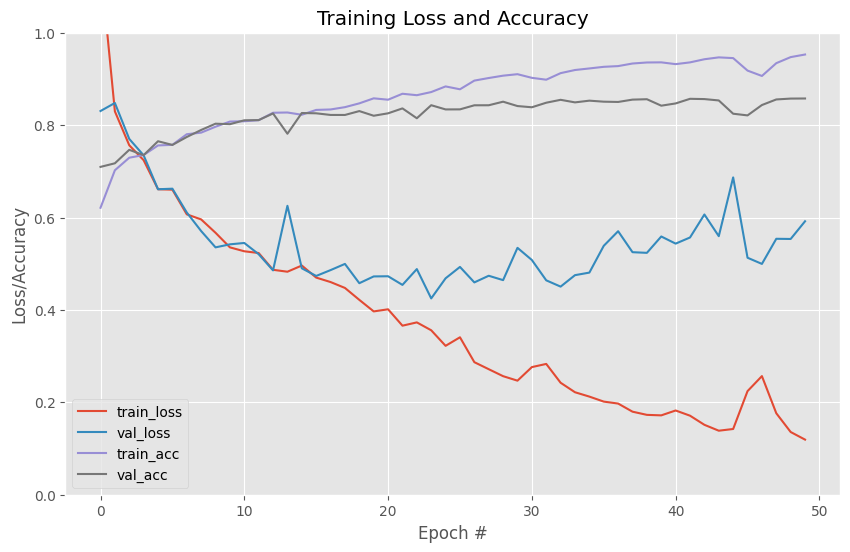

In [16]:
## 打印训练曲线，确认训练效果，精度不够，loss不收敛，模型学习能力不足且容易过拟合
def plot_fig(H,outdir):
    N=len(H.history['loss'])
    plt.style.use("ggplot")
    plt.figure(figsize=(10,6))
    plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
    plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
    plt.plot(np.arange(0, N), H.history["accuracy"], label="train_acc")
    plt.plot(np.arange(0, N), H.history["val_accuracy"], label="val_acc")
    plt.ylim(0,1)
    plt.title("Training Loss and Accuracy")
    plt.xlabel("Epoch #")
    plt.ylabel("Loss/Accuracy")
    plt.legend(loc="lower left")
    plt.savefig(outdir)
plot_fig(result,modelname+"_Loss_Acc_epoch.png")

### 4. 评价测试

In [17]:
## 训练过程只保留最有性能参数文件，因此从训练记录里选择最后一个即可
h5=glob.glob("./checkpoint/"+modelname+"/*.hdf5")
model_list=np.sort(h5)
model=load_model(model_list[-1])
# model=load_model(model_list[-1],custom_objects={'interpolation':interpolation})#keras导入模型需要判断是会否有自定义函数或层，有的话需要在custom_objects中定义，并编译
print(model_list[-1])

./checkpoint/unet\-24e-val_loss0.424916.hdf5


In [18]:
## 首先对切片数据进行预测，查看效果
i=100
pred=model.predict(xtest,batch_size=64)
pred=np.argmax(pred,axis=-1)
gt=np.argmax(ytest,axis=-1)


9/9 [==============================] - 9s 530ms/step


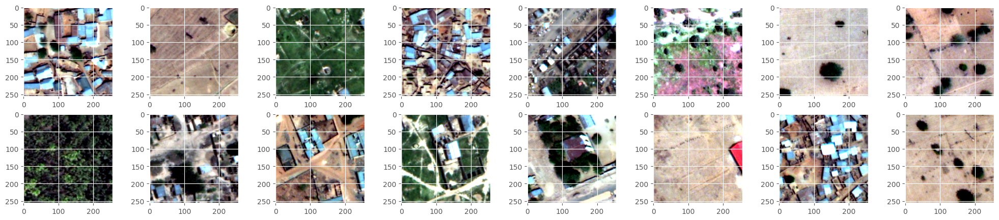

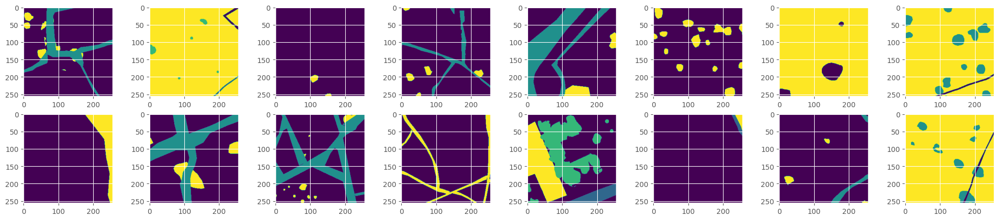

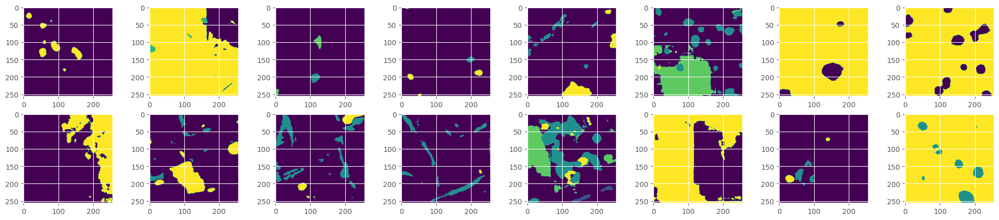

In [19]:
##逐批次查看预测效果
val_plot_func(xtest[i:i+20],gt[i:i+20],pred[i:i+20])
i+=100

In [22]:
## 用测试集评价模型精度
df = call_matric(pred,gt, [0,1,2,3,4, 'all'])
print(df)

     precision    recall  F1-score       iou        oa      miou
0     0.850384  0.895335  0.872280  0.773491  0.843104  0.519765
1     0.716035  0.285363  0.408089  0.256352  0.843104  0.519765
2     0.754666  0.684739  0.718004  0.560067  0.843104  0.519765
3     0.862850  0.904145  0.883015  0.790534  0.843104  0.519765
4     0.466484  0.291084  0.358479  0.218382  0.843104  0.519765
all   0.730084  0.612133  0.647973  0.519765  0.843104  0.519765


### 4. 优化改进

#### 4.1 数据优化

[99016105, 11047398, 17424954, 76998497, 1951446]


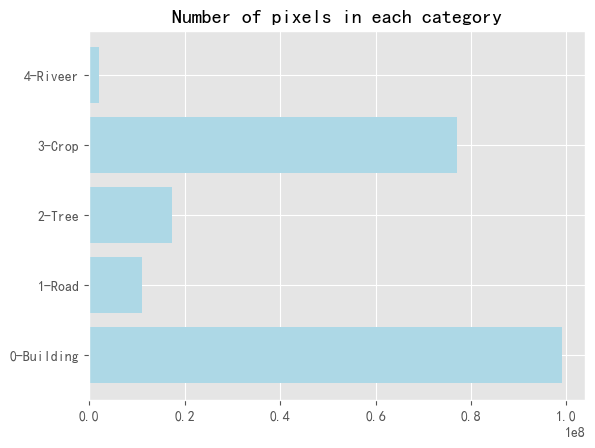

In [15]:
build_num = np.sum(labels ==0)
road_num = np.sum(labels == 1)
tree_num = np.sum(labels == 2)
crop_num = np.sum(labels == 3)
water_num = np.sum(labels == 4)
# 这两行代码解决 plt 中文显示的问题
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False
plt.style.use("ggplot")

classes = ('0-Building', '1-Road', '2-Tree', '3-Crop', '4-Riveer')
numbers = [build_num,road_num, tree_num,crop_num, water_num]
print(numbers)
plt.barh(classes, numbers,color='lightblue')
plt.title('Number of pixels in each category')
# plt.savefig("Number-category.png", dpi = 600, bbox_inches="tight")
plt.show()

In [26]:
## 定义随机裁剪增加对于label中1和4样本的采集,"num_count(image[:,:,-1],1)"表示切片中数值为1的像元个数
def data_crop_random2(img_arr,crop_sz,n_patch):   
    data =[]
    k=0
    for j in np.arange(1000):
        image = random_crop(img_arr,crop_sz)
        if num_count(image[:,:,-1],1) +num_count(image[:,:,-1],4) >8000:
            data.append(image)
            k+=1
            if k==n_patch:
                break                 
    if k == 0:
        data  = np.expand_dims(image,axis=0) ##注意如果k=0，即没有符合条件的数据将最后一个image赋给data，避免data为空
    else:
        data  = np.array(data,dtype=np.float32)

    print(data.shape)
    return data.astype(np.float32)
def data_crop2(imagearray,crop_sz,stride,random=None,n_patch=250):   
    data = []
    for i in range(imagearray.shape[0]):
        if random:
            image=data_crop_random2(imagearray[i,:,:,:],crop_sz,n_patch)
        else:
            image =sequential_crop(imagearray[i,:,:,:],crop_sz,stride)
        if i == 0:
            data  = image ##注意当i=0的时候需要将image赋给data，否则data依然是空，不可以进行concatnate
        else:
            data  = np.concatenate((data, image), axis = 0) 
        print("patch processing....:"+str(i))
    data=np.array(data,dtype=np.float32)
    print("final processed:"+str(i)+"...No.:"+str(data.shape[0]))    
    return data

In [27]:
## 同样使用前面14幅影像进行切片，增加不平衡样本数据的采集
# data_all = np.concatenate((newimg, np.expand_dims(labels,axis=-1)), axis = -1)
# stride=256
# cropsize=256
all_patches2=data_crop2(data_all,cropsize,stride,random=True)
print(data_all.shape,all_patches2.shape)
i=0


(1, 256, 256, 4)
patch processing....:0
(1, 256, 256, 4)
patch processing....:1
(207, 256, 256, 4)
patch processing....:2
(1, 256, 256, 4)
patch processing....:3
(250, 256, 256, 4)
patch processing....:4
(250, 256, 256, 4)
patch processing....:5
(63, 256, 256, 4)
patch processing....:6
(197, 256, 256, 4)
patch processing....:7
(151, 256, 256, 4)
patch processing....:8
(250, 256, 256, 4)
patch processing....:9
(68, 256, 256, 4)
patch processing....:10
(171, 256, 256, 4)
patch processing....:11
(24, 256, 256, 4)
patch processing....:12
(81, 256, 256, 4)
patch processing....:13
final processed:13...No.:1715
(14, 3840, 3840, 4) (1715, 256, 256, 4)


In [28]:
all_patches2=suffle_data(all_patches2)# 对新的数据集进行随机打乱

(1715, 256, 256, 4)


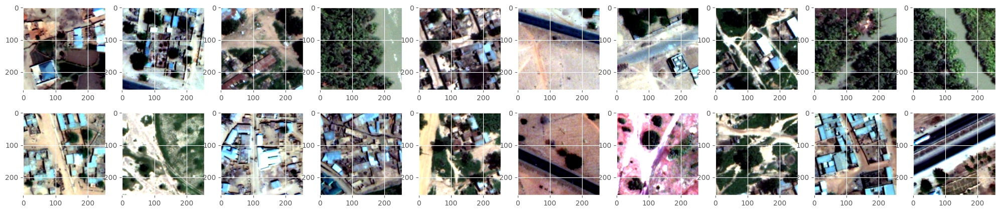

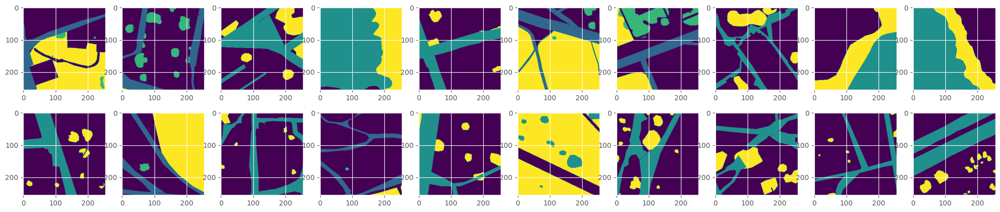

In [29]:
# plot_func(all_patches2[i:i+20,:,:,:3],all_patches2[i:i+20:,:,:,-1])
# i+=500

In [30]:
## 加载前面生成的切片数据
# hdf5_path = "./data/patches_rgb_4b_5c.hdf5"
# fd = h5py.File(hdf5_path, 'r')
# fd.keys()
# images2=np.array(fd['image'])
# labels2=np.array(fd['label'])

In [31]:
## 对两次切片数据进行合并，得到新的数据集
newimages=np.concatenate((images2,all_patches2[:,:,:,0:-1]),axis=0)
newlabels=np.concatenate((labels2,all_patches2[:,:,:,-1]),axis=0)
print(newimages.shape,newlabels.shape)


(4459, 256, 256, 3) (4459, 256, 256)


In [32]:
##可以选择将数据保存为h5文件，方便后续使用
hdf5_path = './data/patches2_rgb_4b_5c.hdf5' 
f = h5py.File(hdf5_path, mode='w')
f['image'] = newimages
f['label'] = newlabels
f.close()

In [7]:
# hdf5_path = './data/patches2_rgb_4b_5c.hdf5' 
# fd = h5py.File(hdf5_path, 'r')
# fd.keys()
# newimages=np.array(fd['image'])
# newlabels=np.array(fd['label'])#3:tree,4:road,5:crop

In [34]:
## 对数据进行归一化处理，并将label转成one-hot标签形式
n_label=5
def post_normalize_image(images,labels,n_label=n_label):
    msk = label_hot(labels,n_label)
    img = images
    return img,msk
img,msk=post_normalize_image(newimages,newlabels,n_label)
# 将数据集按照7:3进行划分
xtrain,xtest,ytrain,ytest=train_test_split(img,msk,test_size=0.2,random_state=42)
del img,msk #如果数据较大可以在此删除降低内存
print(xtrain.shape,xtest.shape,ytrain.shape,ytest.shape)
i=0

(3567, 256, 256, 3) (892, 256, 256, 3) (3567, 256, 256, 5) (892, 256, 256, 5)


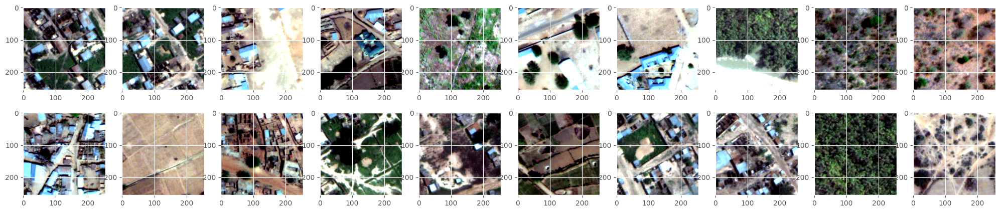

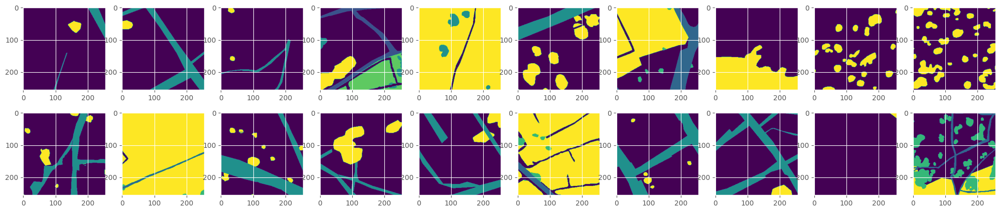

In [35]:
plot_func(xtrain[i:i+20,:,:,:3],np.argmax(ytrain,axis=-1)[i:i+20:,:,:])
i+=500

#### 4.2 模型优化

In [36]:
## 计算真值标签中各个类别的占比，作为损失函数的权重，权重值越大模型识别错误代价越大一定程度缓解数据不平衡问题。
# from sklearn.utils.class_weight import compute_class_weight
# classes = np.unique(labels)  
# class_weight = compute_class_weight(class_weight='balanced', classes=classes, y=labels.reshape(-1))
class_weight=np.array([0.35,4.48,2.07,0.68,28.55])
print(class_weight)

[ 0.35  4.48  2.07  0.68 28.55]


In [37]:
## 采用带有权重的交叉熵损失函数
from keras import backend as K
import tensorflow as tf
def weighted_categorical_crossentropy(weights):
    """
    Usage:
        weights = np.array([0.5,2,10]) # Class one at 0.5, class 2 twice the normal weights, class 3 10x.
        loss = weighted_categorical_crossentropy(weights)
    """
    weights = K.variable(weights)
    def loss(y_true, y_pred):
        # scale predictions so that the class probas of each sample sum to 1
        y_pred /= K.sum(y_pred, axis=-1, keepdims=True)
        # clip to prevent NaN's and Inf's
        y_pred = K.clip(y_pred, K.epsilon(), 1 - K.epsilon())
        # calc
        loss = y_true * K.log(y_pred) * weights
        loss = -K.sum(loss, -1)
        return loss
    return loss


In [38]:
## 设定必要的参数
loss=weighted_categorical_crossentropy(class_weight)
optimizer=Adam()
loss_weights=''
metrics=['accuracy']
batch_size=10
epoch= 50
input_height=xtrain.shape[1]
input_width=xtrain.shape[2]
nchannel=xtrain.shape[-1]
num_train=xtrain.shape[0]
num_val=xtest.shape[0]
ATM=all_model(loss,loss_weights,optimizer,metrics,input_height,input_width,n_label,nchannel)
modelname='convattunet'

In [39]:
## unet下采样操作较多导致细小线状地物信息丢失，新的网络减少下采样，且在decoder部分采用注意力机制提升浅层特征的权重
model=ATM.convattunet()#deeplabv3p,UNET,dlinknet,convattunet
# model.summary()

384


In [40]:
## 开始训练
begin_time = time.time()          
out_dir = "./checkpoint/"+modelname+'/'
if not os.path.exists(out_dir):
    os.makedirs(out_dir) 
model_checkpoint = ModelCheckpoint(filepath=out_dir+"-{epoch:02d}e-val_loss{val_loss:2f}.hdf5",monitor="val_loss",save_best_only=True,mode='auto')
csvlogger =CSVLogger(filename=out_dir+modelname+'-'+str(epoch)+'-log.csv', separator=',', append=False)
result=model.fit(xtrain, ytrain, batch_size=batch_size, epochs=epoch, verbose=1, shuffle=True,validation_data=(xtest, ytest),callbacks=[model_checkpoint,csvlogger])
end_time = time.time()
print('time lapsing {0} s \n'.format(end_time - begin_time))

Epoch 1/50
357/357 [==============================] - 132s 344ms/step - loss: 1.7302 - accuracy: 0.3324 - val_loss: 2.7731 - val_accuracy: 0.0355
Epoch 2/50
357/357 [==============================] - 117s 328ms/step - loss: 1.1811 - accuracy: 0.4554 - val_loss: 1.1779 - val_accuracy: 0.4066
Epoch 3/50
357/357 [==============================] - 117s 329ms/step - loss: 1.3168 - accuracy: 0.3951 - val_loss: 1.1310 - val_accuracy: 0.5230
Epoch 4/50
357/357 [==============================] - 115s 323ms/step - loss: 1.2823 - accuracy: 0.4182 - val_loss: 1.2304 - val_accuracy: 0.4714
Epoch 5/50
357/357 [==============================] - 115s 323ms/step - loss: 1.0932 - accuracy: 0.4740 - val_loss: 2.0796 - val_accuracy: 0.4236
Epoch 6/50
357/357 [==============================] - 116s 324ms/step - loss: 1.0692 - accuracy: 0.4806 - val_loss: 1.8193 - val_accuracy: 0.2795
Epoch 7/50
357/357 [==============================] - 117s 328ms/step - loss: 0.9390 - accuracy: 0.5248 - val_loss: 0.8420 -

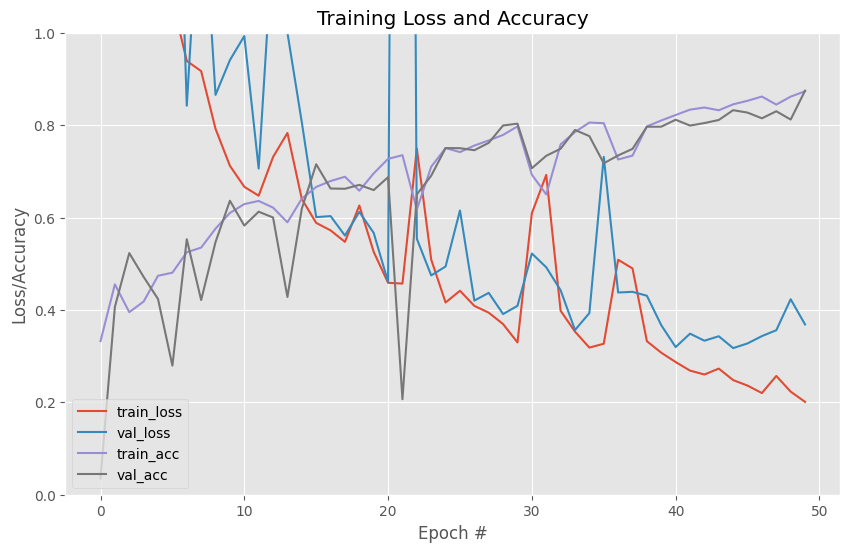

In [41]:
## 训练时长较短，模型为达到收敛因此最高精度不是很高，但训练曲线和验证曲线趋势十分吻合，且loss有明显的降低，表明模型性能有提升
plot_fig(result,modelname+"_Loss_Acc_epoch.png")

In [42]:
h5=glob.glob("./checkpoint/"+modelname+"/*.hdf5")
model_list=np.sort(h5)
# model=load_model(model_list[-1])
model=load_model(model_list[-1],custom_objects={'loss':weighted_categorical_crossentropy}) #loss作为自定义层需要指出
print(model_list[-1])

./checkpoint/convattunet\-45e-val_loss0.317361.hdf5


In [43]:
## 首先对切片数据进行预测，查看效果
i=100
pred=model.predict(xtest,batch_size=64)
pred=np.argmax(pred,axis=-1)
gt=np.argmax(ytest,axis=-1)


14/14 [==============================] - 15s 816ms/step


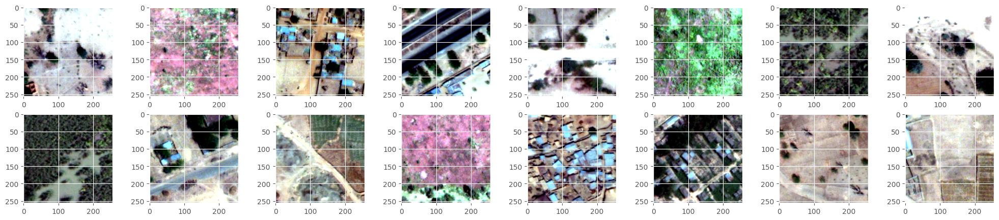

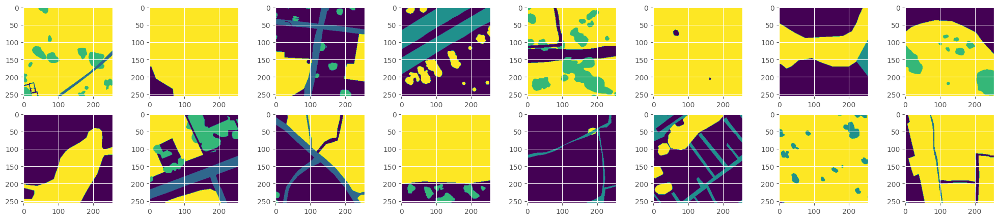

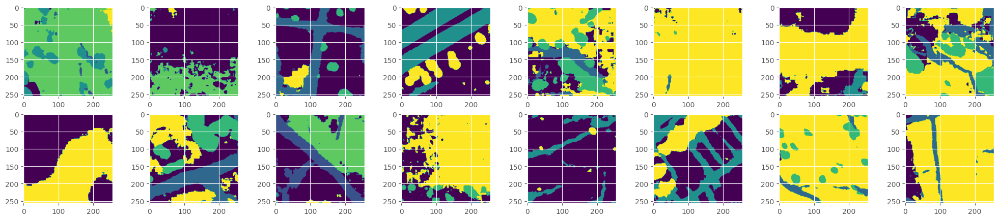

In [44]:
val_plot_func(xtest[i:i+20],gt[i:i+20],pred[i:i+20])
i+=20

In [46]:
## 评估结果发现1类和4类地物较之前都有精度的提升，整体miou提升16%
df = call_matric(pred,gt, [0,1,2,3,4,'all'])
print(df)

     precision    recall  F1-score       iou        oa      miou
0     0.939834  0.777367  0.850915  0.740515  0.832341  0.679057
1     0.544363  0.946242  0.691128  0.528033  0.832341  0.679057
2     0.645177  0.880091  0.744544  0.593047  0.832341  0.679057
3     0.923623  0.863848  0.892736  0.806254  0.832341  0.679057
4     0.730599  0.994085  0.842215  0.727437  0.832341  0.679057
all   0.756720  0.892327  0.804308  0.679057  0.832341  0.679057


#### 4.3 整景影像的预测

In [47]:
## 加载整景的影像进行测试
test_data  = h5py.File('./data/kaggle_test1_3b_5c.hdf5', 'r')
testimg = np.array(test_data['image'])
testlabel=np.array(test_data['label'])
print(testimg.shape,testlabel.shape)

(1, 3840, 3840, 3) (1, 3840, 3840)


In [48]:
## 与训练数据采用相同的预处理方式
image=adjust_contrast(testimg)
np.max(image),np.max(testimg)

(1.0, 9995)

In [49]:
## 首先对影像做padding，保证其能够被crop_size整除，先沿着行列分别裁切样本，再统一进行预测，预测后数据按照原来的顺序再排列组合复原。需要注意的是这里采用的是膨胀预测的方法，喂给模型用来预测的切片大小是256，但放的时候只保留了中间的128×128，四周数据可靠度低，直接废弃
def center_predict(img,model,batch_size,n_label,strides=128,img_size=256):
    corner_size=int(0.25*img_size)
    h,w,c = img.shape
    padding_h = (h//strides + 1) * strides+corner_size+corner_size
    padding_w = (w//strides + 1) * strides+corner_size+corner_size
    
    padding_img = np.zeros((padding_h,padding_w,c),dtype=np.float16)
    padding_img[corner_size:corner_size+h,corner_size:corner_size+w,:] = img[:,:,:]
    mask_whole = np.zeros((padding_h,padding_w,n_label),dtype=np.float16)
    crop_batch=[]
    for i in range(h//strides+1):
        for j in range(w//strides+1):
            crop_img = padding_img[i*strides:i*strides+img_size,j*strides:j*strides+img_size,:]
            ch,cw,c = crop_img.shape
            
            if ch != img_size or cw != img_size:
                continue
            crop_batch.append(crop_img)
            
    crop_batch=np.array(crop_batch)
    start_time=time.time()
    pred=model.predict(crop_batch,batch_size=batch_size)

    for i in range(h//strides+1):
        for j in range(w//strides+1):
            mask_whole[i*strides+corner_size:i*strides+img_size-corner_size,j*strides+corner_size:j*strides+img_size-corner_size] = pred[(i+1-1)*(w//strides+1)+(j+1)-1,corner_size:img_size-corner_size,corner_size:img_size-corner_size]
    score = mask_whole[corner_size:corner_size+h,corner_size:corner_size+w]
    end_time=time.time()
    print('pred_time:',end_time-start_time)
    return score

In [50]:
h_pred = center_predict(image[0],model,32,n_label)
h_pred_mask=np.argmax(h_pred, axis = -1)
print(h_pred.shape,testlabel[0].shape)

31/31 [==============================] - 11s 292ms/step
pred_time: 14.90808916091919
(3840, 3840, 5) (3840, 3840)


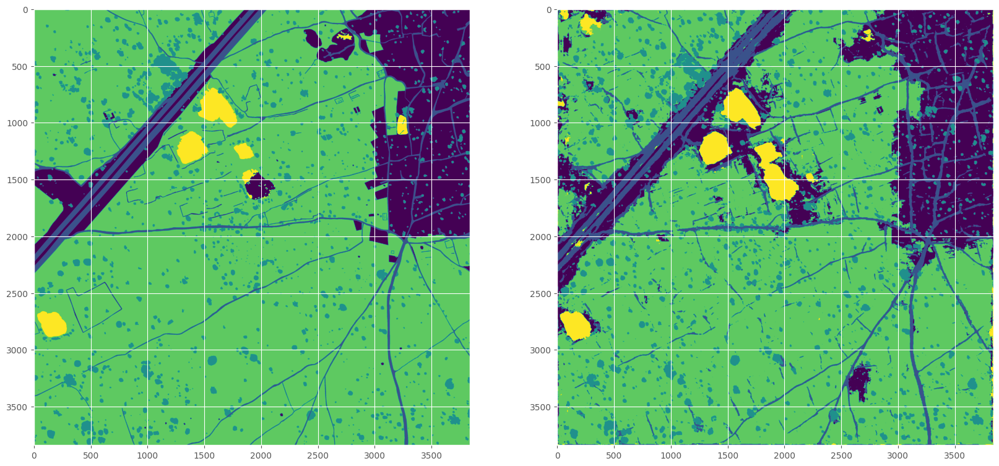

In [65]:
fig=plt.figure(figsize=(20,20)) 
plt.subplot(1,2,1)
plt.imshow(testlabel[0,:,:])
plt.subplot(1,2,2)
plt.imshow(h_pred_mask)
plt.show()